In [69]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [70]:
import sys
sys.path.append('/tank/klundert/projects/cfdn/prfpy_cfdn/')
import os
import numpy as np
import preprocess
import glob
import natsort
import cortex as cx
import numpy as np
import scipy as sp
import nilearn as nl
from nilearn.surface import load_surf_data
import os, shutil, urllib.request
import cortex as cx
from matplotlib import rc
import nibabel as nb
from nibabel import cifti2
import h5py
import matplotlib.pyplot as plt
from prfpy.stimulus import PRFStimulus2D
from prfpy.model import Iso2DGaussianModel, CSS_Iso2DGaussianModel
from prfpy.fit import Iso2DGaussianFitter, CSS_Iso2DGaussianFitter
from prfpy.utils import Subsurface
from prfpy.stimulus import CFStimulus
from prfpy.model import CFGaussianModel
from prfpy.fit import CFFitter
from prfpy.model import Norm_CFGaussianModel
from prfpy.fit import Norm_CFGaussianFitter
from scipy.optimize import LinearConstraint, NonlinearConstraint
from scipy.io import loadmat
from scipy.ndimage import median_filter, gaussian_filter, binary_propagation
from preprocess import get_cortex
# import cfhcpy
# from cfhcpy.base import AnalysisBase
import pandas as pd
import h5py
from scipy.stats import sem
from scipy.stats import f_oneway
# import scikit_posthocs as sp
from copy import deepcopy

In [4]:
idxs = h5py.File('/tank/shared/timeless/atlases/cifti_indices.hdf5', "r")
lidxs = np.array(idxs['Left_indices'])
ridxs = np.array(idxs['Right_indices'])
allidxs = np.concatenate([lidxs, ridxs])
def get_cortex(dat):
    l, r, = dat[lidxs], dat[ridxs]

    # Replace the minus 1
    l[lidxs == -1] = np.zeros_like(l[lidxs == -1])
    r[ridxs == -1] = np.zeros_like(r[ridxs == -1])

    # Last dimension time.
    # l, r = l.T, r.T

    data = np.concatenate([l, r])
    return data

def angle(x0, y0):
    return np.angle(x0 + y0 * 1j)

def ecc(x0, y0):
    return np.abs(x0 + y0 * 1j)

def splitList(array):
    n = len(array)
    half = int(n/2) # py3
    return array[:half], array[n-half:]



roi_index_dict = {
    # somatosensory:
    'CS1_4': 8, 'CS2_3a': 53, 'CS3_3b': 9, 'CS4_1': 51, 'CS5_2': 52,
    # auditory:
    'A1': 24, 'PBelt': 124, 'MBelt': 173, 'LBelt': 174, '52': 103, 'RI': 104,
    # low-level visual:
    'V1': 1, 'V2': 4, 'V3': 5,
    # mid-level and high-level visual:
    'V3A': 13, 'V3B': 19, 'IPS1': 17, 'LIPv': 48, 'LIPd': 95, 
    'VIP': 49, 'MST': 2, 'MT': 23, 'LO1': 20, 'LO2': 21, 'LO3': 159, 'MIP': 50
    }


roi_index_dict2 = {
    # somatosensory:
    'CS1_4': 8, 'CS2_3a': 53, 'CS3_3b': 9, 'CS4_1': 51, 'CS5_2': 52,
    # auditory:
    'A1': 24, 'PBelt': 124, 'MBelt': 173, 'LBelt': 174, '52': 103, 'RI': 104,
    # low-level visual:
    'V1': 1, 'V2': 4, 'V3': 5, 'V4': 6,
    # mid-level and high-level visual:
    'V3AB': [13, 19], 'IPS1': 17, 'LIPv': 48, 'LIPd': 95, 
    'VIP': 49, 'MST': 2, 'MT': 23, 'LO': [20, 21,  159]
    }

atlas_data = np.concatenate([load_surf_data(
        os.path.join('/tank/klundert/content/data/atlas', f'Q1-Q6_RelatedParcellation210.CorticalAreas_dil_Colors.59k_fs_LR.dlabel.{hemi}.gii'))
         for hemi in ['L', 'R']])
atlas_data_both_hemis = np.mod(atlas_data, 180)


    
boolmask = np.load('/tank/klundert/projects/cfdn/data/CF_fit_utils/visual_mask_hcp.npy')

In [85]:
## data average all folds/subs for each model plus add the average x and y values

### non-WEIGHTED

all_data_gauss = []
all_data_DN = []


for i, sub in enumerate([2]):
    print(sub)
    
    
    for model in ['gauss_prf', 'DN_prf']:
        both_folds = []
        # print(model)
        for folds in [0,1]:

            for j, infile in enumerate(natsort.natsorted((glob.glob(f'/tank/klundert/hcp_space_data/hcp_data/{model}_sub-{sub}_fold-{folds}_slice-*.npy')))):
                # print(j)
                if j == 0:
                    dattest = np.load(infile)
                else:
                    dattest = np.vstack([dattest, np.load(infile)])

                
            both_folds.append(dattest)
        if model == 'gauss_prf':
            all_data_gauss.append(np.mean(both_folds, axis=0))
            
        if model == 'DN_prf':
            all_data_DN.append(np.mean(both_folds, axis=0))
            
prf_gauss = get_cortex(all_data_gauss[0])
prf_dn = get_cortex(all_data_DN[0])
prf_dn.shape
prf_gauss.shape

2


(118584, 8)

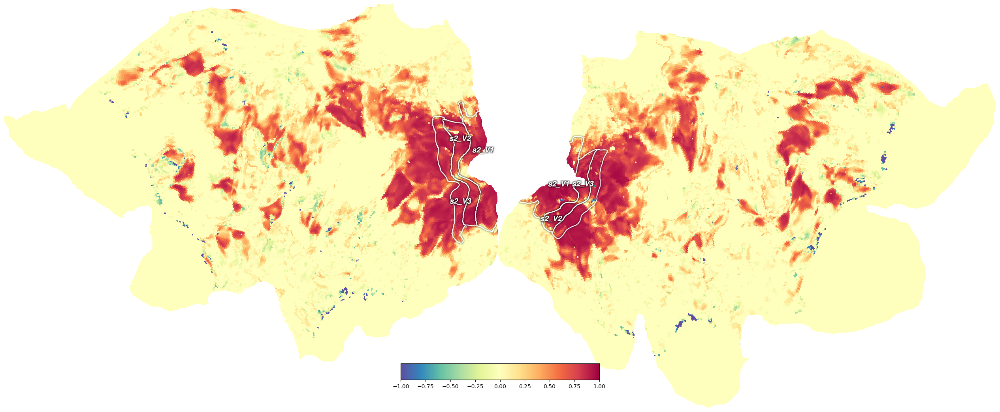

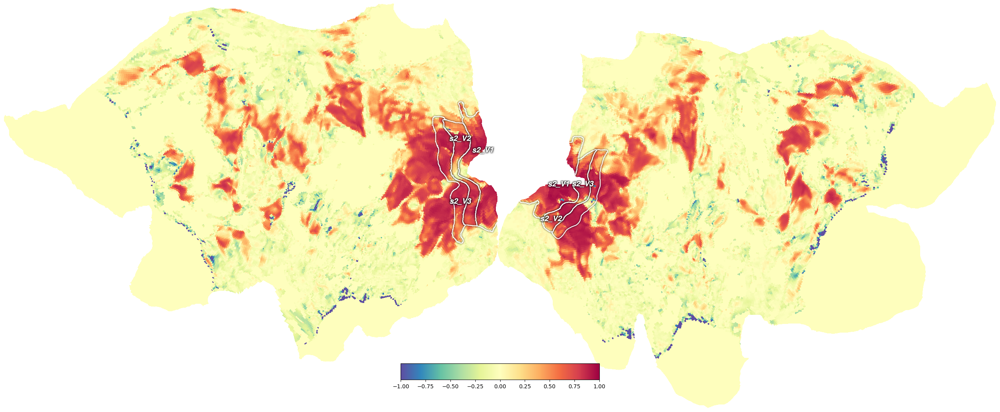

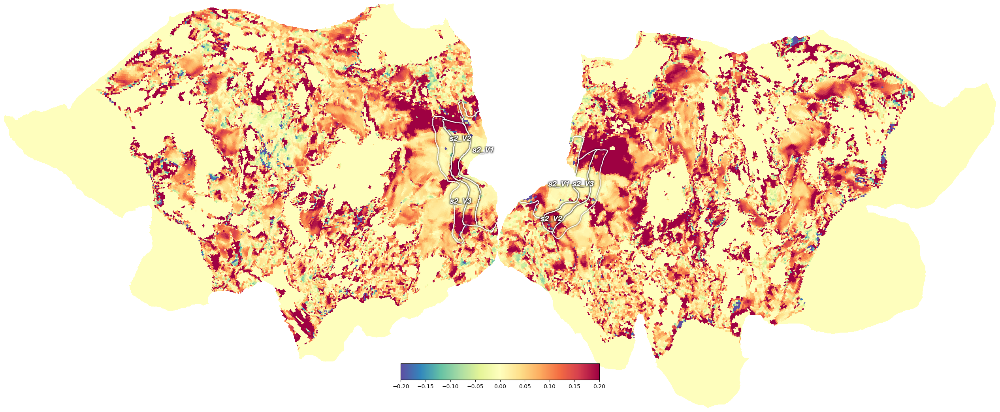

In [86]:
subject = 'sub-02'

toplot = prf_dn[:,-1]
cx.quickshow(cx.Vertex(toplot, subject='hcp_999999', cmap='spectral_r', vmin=-1, vmax=1), with_curvature=True);

toplot = prf_gauss[:,-1]
cx.quickshow(cx.Vertex(toplot, subject='hcp_999999', cmap='spectral_r', vmin=-1, vmax=1), with_curvature=True);

toplot = prf_dn[:,-1] - prf_gauss[:,-1]
cx.quickshow(cx.Vertex(toplot, subject='hcp_999999', cmap='spectral_r', vmin=-0.2, vmax=0.2), with_curvature=True);

In [12]:
for i in np.arange(0, 350):
    # natsort.natsorted((glob.glob(f'/tank/klundert/fsnative_data/DN_prf_sub-1_all_slice-*.npy')))
    np.load(f'/tank/klundert/fsnative_data_u/gauss_prf_sub-1_all_slice-{i}.npy')

/tmp/ipykernel_1913670/3959003967.py:1: RuntimeWarning: invalid value encountered in divide
  amplitude_sign = (prf_gauss[:,3] / np.abs(prf_gauss[:,3])) * prf_gauss[:,-1]
/tmp/ipykernel_1913670/3959003967.py:7: RuntimeWarning: invalid value encountered in divide
  amplitude_sign_dn = (prf_dn[:,3] / np.abs(prf_dn[:,3])) * prf_dn[:,-1]


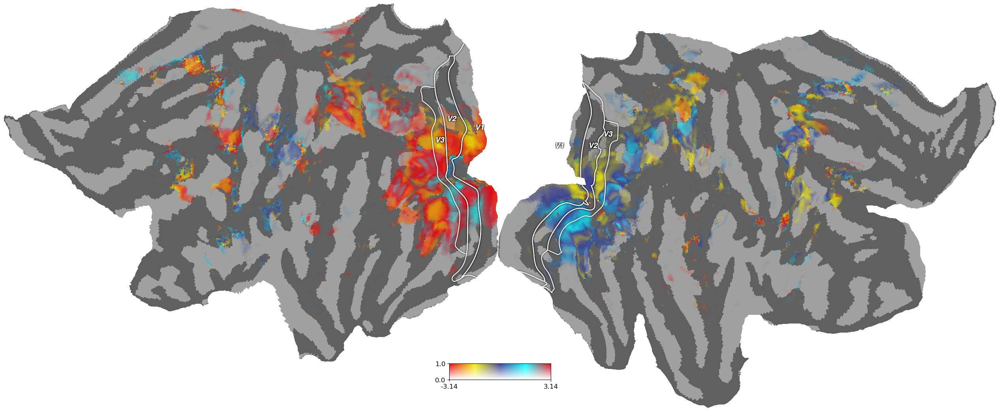

In [73]:
amplitude_sign = (prf_gauss[:,3] / np.abs(prf_gauss[:,3])) * prf_gauss[:,-1]

rsq_amp = np.copy(prf_gauss[:,-1])
rsq_amp[amplitude_sign < 0] = 0


amplitude_sign_dn = (prf_dn[:,3] / np.abs(prf_dn[:,3])) * prf_dn[:,-1]

rsq_amp_dn = np.copy(prf_dn[:,-1])
rsq_amp_dn[amplitude_sign_dn < 0] = 0

subject = 'hcp_999999'

vert_angle_a = cx.Vertex2D(angle(prf_dn[:,1], prf_dn[:,0]*-1), prf_dn[:,-1], subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)
vert_angle_a2 = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), prf_gauss[:,-1], subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)


vert_angle2_a = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='Retinotopy_RYBCR_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)
vert_angle3_a = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)

vert_ecc_a = cx.Vertex2D(ecc(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='nipy_spectral_alpha', vmin=0, vmax=10, vmin2=0, vmax2=1)
sub = 2

# cx.utils.add_roi(vert_angle2_a, name=f's{sub}_angle_a');
# cx.utils.add_roi(vert_angle2_a, name=f's{sub}_angle2_a');
# cx.utils.add_roi(vert_ecc_a, name=f's{sub}_ecc_a');
# angle_a = angle(prf_gauss[:,1], prf_gauss[:,0]*-1)
# vert_angle_as = cx.Vertex(angle_a, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi)

# cx.quickshow(vert_angle_a, with_curvature=True);
# cx.quickshow(vert_angle_a2, with_curvature=True);


cx.quickshow(vert_angle2_a, with_curvature=True);
# cx.quickshow(vert_angle3_a, with_curvature=True);


# webgl_data = {'s1_angle2': vert_angle_as}


# cx.webgl.show(webgl_data, port=8813);


/tmp/ipykernel_834194/2392925050.py:1: RuntimeWarning: invalid value encountered in divide
  amplitude_sign = (prf_gauss[:,3] / np.abs(prf_gauss[:,3])) * prf_gauss[:,-1]
/tmp/ipykernel_834194/2392925050.py:7: RuntimeWarning: invalid value encountered in divide
  amplitude_sign_dn = (prf_dn[:,3] / np.abs(prf_dn[:,3])) * prf_dn[:,-1]


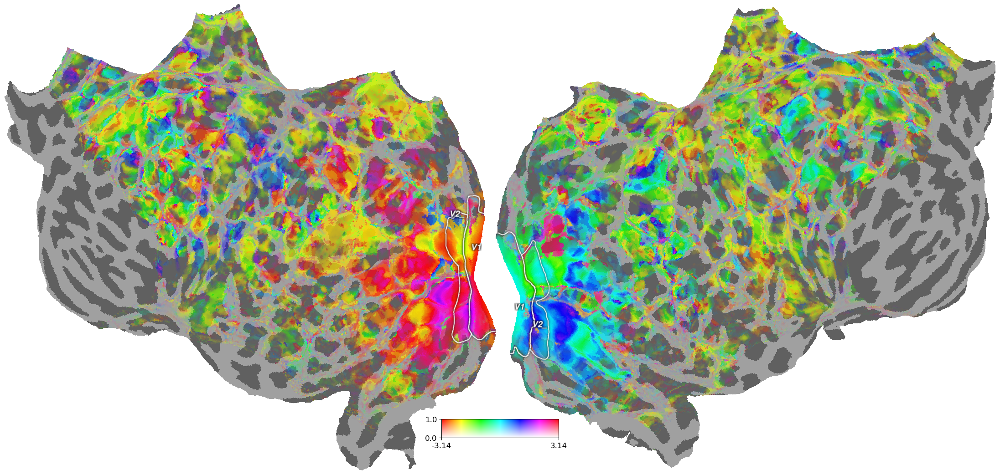

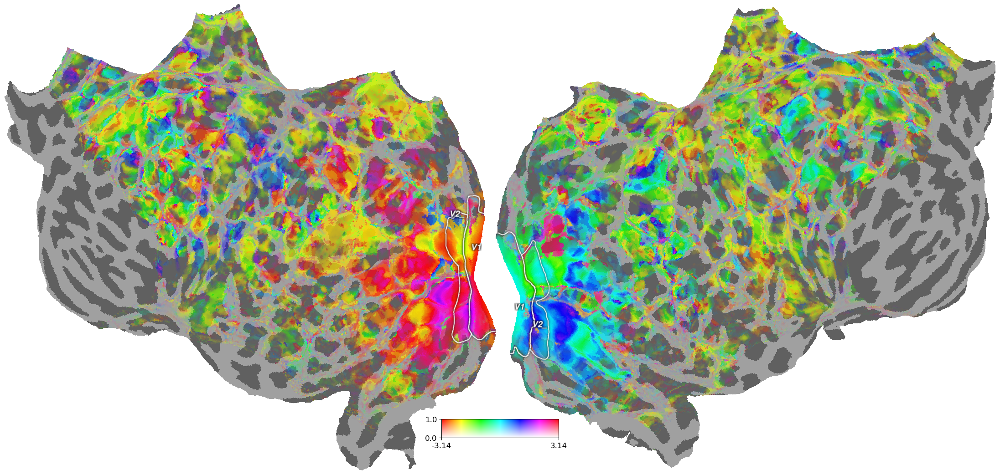

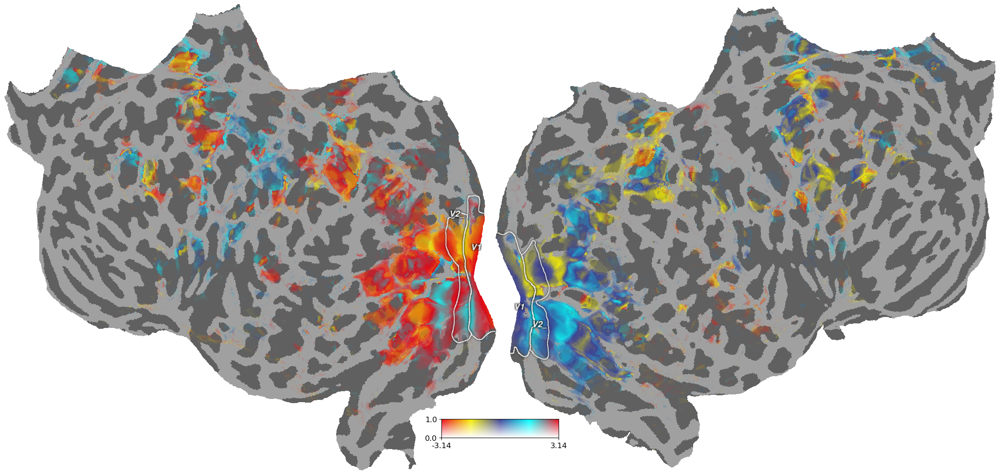

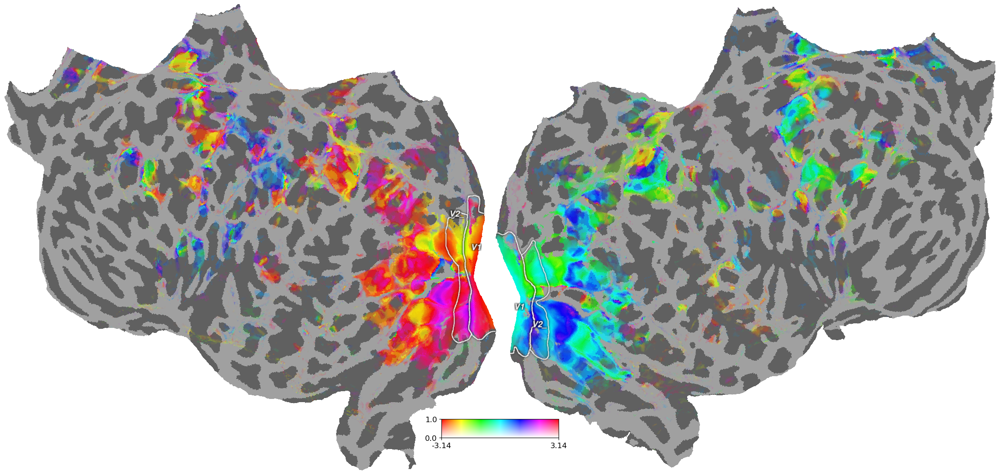

In [23]:
amplitude_sign = (prf_gauss[:,3] / np.abs(prf_gauss[:,3])) * prf_gauss[:,-1]

rsq_amp = np.copy(prf_gauss[:,-1])
rsq_amp[amplitude_sign < 0] = 0


amplitude_sign_dn = (prf_dn[:,3] / np.abs(prf_dn[:,3])) * prf_dn[:,-1]

rsq_amp_dn = np.copy(prf_dn[:,-1])
rsq_amp_dn[amplitude_sign_dn < 0] = 0

subject = 'sub-02'

vert_angle_a = cx.Vertex2D(angle(prf_dn[:,1], prf_dn[:,0]*-1), prf_dn[:,-1], subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)
vert_angle_a2 = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), prf_gauss[:,-1], subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)


vert_angle2_a = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='Retinotopy_RYBCR_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)
vert_angle3_a = cx.Vertex2D(angle(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='Retinotopy_HSV_alpha', vmin=-np.pi, vmax=np.pi, vmin2=0, vmax2=1)

vert_ecc_a = cx.Vertex2D(ecc(prf_gauss[:,1], prf_gauss[:,0]*-1), rsq_amp, subject=subject, cmap='nipy_spectral_alpha', vmin=0, vmax=10, vmin2=0, vmax2=1)
sub = 2

# cx.utils.add_roi(vert_angle_a, name=f's{sub}_angle_a');
# cx.utils.add_roi(vert_angle2_a, name=f's{sub}_angle2_a');
# cx.utils.add_roi(vert_ecc_a, name=f's{sub}_ecc_a');
# angle_a = angle(prf_gauss[:,1], prf_gauss[:,0]*-1)
# vert_angle_as = cx.Vertex(angle_a, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi)

cx.quickshow(vert_angle_a, with_curvature=True);
cx.quickshow(vert_angle_a2, with_curvature=True);


cx.quickshow(vert_angle2_a, with_curvature=True);
cx.quickshow(vert_angle3_a, with_curvature=True);


# webgl_data = {'s1_angle2': vert_angle_as}


# cx.webgl.show(webgl_data, port=8813);


In [54]:
## data average all folds/subs for each model plus add the average x and y values

### non-WEIGHTED

all_data_gauss = []
all_data_DN = []


for i, sub in enumerate([2]):
    print(sub)
    
    
    for model in ['gauss_prf', 'DN_prf']:
        both_folds = []
        # print(model)
        for folds in [0]:

            for j, infile in enumerate(natsort.natsorted((glob.glob(f'/tank/klundert/fsnative_folds_prf/fsnative_data2/{model}_sub-{sub}_fold-{folds}_slice-*.npy')))):
                # print(j)
                if j == 0:
                    dattest = np.load(infile)
                else:
                    dattest = np.vstack([dattest, np.load(infile)])

                
            both_folds.append(dattest)
        if model == 'gauss_prf':
            all_data_gauss.append(np.mean(both_folds, axis=0))
            
        if model == 'DN_prf':
            all_data_DN.append(np.mean(both_folds, axis=0))
            
prf_gauss = all_data_gauss[0] 
prf_dn = all_data_DN[0]
prf_dn.shape

2


(277492, 12)

In [63]:
## data average all folds/subs for each model plus add the average x and y values

### WEIGHTED

all_data_gauss = []
all_data_DN = []


for i, sub in enumerate([2]):
    print(sub)
    
    
    for model in ['gauss_prf', 'DN_prf']:
        both_folds = []
        # print(model)
        for folds in [0,1]:

            for j, infile in enumerate(natsort.natsorted((glob.glob(f'/tank/klundert/fsnative_folds_prf/fsnative_data2/{model}_sub-{sub}_fold-{folds}_slice-*.npy')))):
                # print(j)
                if j == 0:
                    dattest = np.load(infile)
                else:
                    dattest = np.vstack([dattest, np.load(infile)])

                
            both_folds.append(dattest)
        if model == 'gauss_prf':
            a = np.array(both_folds)[:,:,-1]
            a[a<0] = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_gauss.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'DN_prf':
            a = np.array(both_folds)[:,:,-1]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_DN.append(np.average(both_folds, axis=0, weights=b))
            
prf_gauss = all_data_gauss[0] 
prf_dn = all_data_DN[0]


2


In [167]:
prf_dn.shape

(277492, 12)

In [110]:
#### CF fits

## data average all folds/subs for each model plus add the average x and y values

all_data_cf_cortical = []
all_data_cf_vis = []
all_data_cf_logvis = []
all_data_dncf_cortical = []
all_data_dncf_vis = []
all_data_dncf_logvis = []

for i, sub in enumerate([2]):
    # gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold1.npy'))

    x, y = prf_dn[:,0], prf_dn[:,1]
    d = {'x': x, 'y': y}
    ret_frame = pd.DataFrame(data=d)
    for model in ['CF_cortical', 'CF_vis', 'CF_logvis', 'DNCF_cortical', 'DNCF_vis', 'DNCF_logvis']:
        both_folds = []
#         print(model)
        for fold in [0,1]:
                for j, infile in enumerate(natsort.natsorted((glob.glob(f'/tank/klundert/fsnative_cf/data/{model}_fit_sub-{sub}_fold-{fold}_slice-*.npy')))):
#                     print(infile)
                    if j == 0:
                        dattest = np.load(infile)
                    else:
                        dattest = np.vstack([dattest, np.load(infile)])
                        
                spliced_lookup=ret_frame.iloc[dattest[:,3].astype(int)]
                dattest = np.hstack([dattest, np.asarray(spliced_lookup)])
                both_folds.append(dattest)
        if model == 'CF_cortical':
            all_data_cf_cortical.append(np.mean(both_folds, axis=0))
        if model == 'CF_vis':
            all_data_cf_vis.append(np.mean(both_folds, axis=0))
        if model == 'CF_logvis':
            all_data_cf_logvis.append(np.mean(both_folds, axis=0))
        if model == 'DNCF_cortical':
            all_data_dncf_cortical.append(np.mean(both_folds, axis=0))
        if model == 'DNCF_vis':
            all_data_dncf_vis.append(np.mean(both_folds, axis=0))
        if model == 'DNCF_logvis':
            all_data_dncf_logvis.append(np.mean(both_folds, axis=0))

In [111]:
cf_vis = np.nanmean(np.asarray(all_data_cf_vis), axis=0)
cf_logvis = np.nanmean(np.asarray(all_data_cf_logvis), axis=0)
cf_cortical = np.nanmean(np.asarray(all_data_cf_cortical), axis=0)

dncf_vis = np.nanmean(np.asarray(all_data_dncf_vis), axis=0)
dncf_logvis = np.nanmean(np.asarray(all_data_dncf_logvis), axis=0)
dncf_cortical = np.nanmean(np.asarray(all_data_dncf_cortical), axis=0)

/tmp/ipykernel_834194/1737944199.py:1: RuntimeWarning: Mean of empty slice
  cf_vis = np.nanmean(np.asarray(all_data_cf_vis), axis=0)
/tmp/ipykernel_834194/1737944199.py:2: RuntimeWarning: Mean of empty slice
  cf_logvis = np.nanmean(np.asarray(all_data_cf_logvis), axis=0)
/tmp/ipykernel_834194/1737944199.py:3: RuntimeWarning: Mean of empty slice
  cf_cortical = np.nanmean(np.asarray(all_data_cf_cortical), axis=0)
/tmp/ipykernel_834194/1737944199.py:5: RuntimeWarning: Mean of empty slice
  dncf_vis = np.nanmean(np.asarray(all_data_dncf_vis), axis=0)
/tmp/ipykernel_834194/1737944199.py:6: RuntimeWarning: Mean of empty slice
  dncf_logvis = np.nanmean(np.asarray(all_data_dncf_logvis), axis=0)
/tmp/ipykernel_834194/1737944199.py:7: RuntimeWarning: Mean of empty slice
  dncf_cortical = np.nanmean(np.asarray(all_data_dncf_cortical), axis=0)


In [92]:
## data average all folds/subs for each model plus add the average x and y values

### WEIGHTED

all_data_cf_cortical = []
all_data_cf_vis = []
all_data_cf_logvis = []
all_data_dncf_cortical = []
all_data_dncf_vis = []
all_data_dncf_logvis = []

for i, sub in enumerate([2]):
    # gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold1.npy'))
    print(i)
    x, y = prf_dn[:,0], prf_dn[:,1]
    d = {'x': x, 'y': y}
    ret_frame = pd.DataFrame(data=d)
    for model in ['CF_cortical', 'CF_vis', 'CF_logvis', 'DNCF_cortical', 'DNCF_vis', 'DNCF_logvis']:
        both_folds = []
#         print(model)
        for fold in [0, 1]:
                for j, infile in enumerate(natsort.natsorted((glob.glob(f'/tank/klundert/fsnative_cf/data/{model}_fit_sub-{sub}_fold-{fold}_slice-*.npy')))):
#                     print(infile)
                    if j == 0:
                        dattest = np.load(infile)
                    else:
                        dattest = np.vstack([dattest, np.load(infile)])
                        
                spliced_lookup=ret_frame.iloc[dattest[:,3].astype(int)]
                dattest = np.hstack([dattest, np.asarray(spliced_lookup)])
                both_folds.append(dattest)
        if model == 'CF_cortical':
            a = np.array(both_folds)[:,:,-3]
            a[a<0] = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_cf_cortical.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'CF_vis':
            a = np.array(both_folds)[:,:,-3]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_cf_vis.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'CF_logvis':
            a = np.array(both_folds)[:,:,-3]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_cf_logvis.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'DNCF_cortical':
            a = np.array(both_folds)[:,:,-3]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_dncf_cortical.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'DNCF_vis':
            a = np.array(both_folds)[:,:,-3]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_dncf_vis.append(np.average(both_folds, axis=0, weights=b))
            
        if model == 'DNCF_logvis':
            a = np.array(both_folds)[:,:,-3]
            a[a<0]  = 1e-6
            a[a==0] = 1e-6
            b = np.repeat(a[:, :, np.newaxis], np.array(both_folds).shape[-1], axis=2)
            all_data_dncf_logvis.append(np.average(both_folds, axis=0, weights=b))
            

0


In [93]:
a = np.array(all_data_cf_vis)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_cf_vis).shape[-1], axis=2)
cf_vis = np.average(all_data_cf_vis, axis=0, weights=b)

a = np.array(all_data_cf_logvis)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_cf_logvis).shape[-1], axis=2)
cf_logvis = np.average(all_data_cf_logvis, axis=0, weights=b)

a = np.array(all_data_cf_cortical)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_cf_cortical).shape[-1], axis=2)
cf_cortical = np.average(all_data_cf_cortical, axis=0, weights=b)


a = np.array(all_data_dncf_vis)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_dncf_vis).shape[-1], axis=2)
dncf_vis = np.average(all_data_dncf_vis, axis=0, weights=b)

a = np.array(all_data_cf_logvis)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_dncf_logvis).shape[-1], axis=2)
dncf_logvis = np.average(all_data_dncf_logvis, axis=0, weights=b)

a = np.array(all_data_cf_cortical)[:,:,-3]
a[a<0]  = 1e-6
a[a==0] = 1e-6
b = np.repeat(a[:, :, np.newaxis], np.array(all_data_dncf_cortical).shape[-1], axis=2)
dncf_cortical = np.average(all_data_dncf_cortical, axis=0, weights=b)


In [196]:
np.load('/tank/klundert/projects/cfdn/data/CF_fit_utils/prf_dm.npy').shape

(120, 100, 100)

In [61]:
cf_vis.shape[0]
boolmask = np.load(f'/tank/klundert/projects/cfdn/data/CF_fit_utils/boolmask_sub-0{sub}_fsnative.npy')
boolmask.sum()
105459

90194

In [7]:
from prfpy.model import Norm_Iso2DGaussianModel

s2_f = get_cortex(np.load('/tank/klundert/projects/cfdn/data/CF_fit_utils/data_fold1_sub-02_psc.npy'))
new_dms = np.load('/tank/klundert/projects/cfdn/data/CF_fit_utils/prf_dm.npy')[5:,:,:]

prf_stim = PRFStimulus2D(screen_size_cm=69, 
                         screen_distance_cm=220, 
                         design_matrix=new_dms.T, 
                         TR=1.5)

grid_nr = 20
max_ecc_size = prf_stim.screen_size_degrees/2.0
sizes, eccs, polars = max_ecc_size * np.linspace(0.25, 1, grid_nr)**2, \
    max_ecc_size * np.linspace(0.1, 1, grid_nr)**2, \
    np.linspace(0, 2*np.pi, grid_nr)

# to set up parameter bounds in iterfit
inf = np.inf
eps = 1e-1
ss = prf_stim.screen_size_degrees

gg = Iso2DGaussianModel(stimulus=prf_stim,
                        filter_predictions=False,
                        filter_type='dc')


gg_norm = Norm_Iso2DGaussianModel(stimulus=prf_stim,
                                    filter_predictions=False,
                                    filter_type='dc',
                                    )

[-4.94300443e+00 -1.11640982e+01  4.48715991e-01 -5.71585455e+00
 -9.71780459e-14  6.38403909e+00  7.99882971e+00  4.40946463e-08
  2.22733863e+00  1.03599750e+00 -3.61252924e-34 -4.53451286e-01]
[ 4.00713408 -3.45984411  4.01884411  0.00958183  0.          1.
  0.          0.78350491]


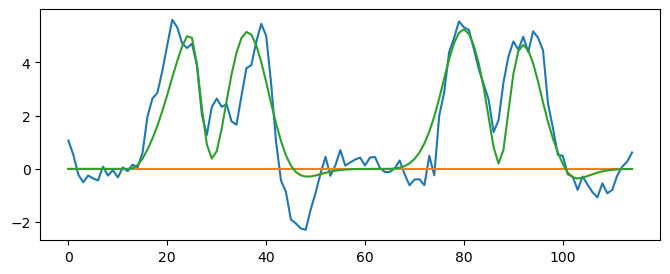

In [12]:
s2_f = np.load('/tank/klundert/projects/cfdn/data/CF_fit_utils/data_fold2_detrend_sub-02_psc_fsnative.npy')


# vox = 26341
vox = 137052
plt.figure(figsize=[8,3])

plt.plot(s2_f[vox,:])

plt.plot(gg_norm.return_prediction(*prf_dn[vox,:-1].T).T, label = f'DN timecourse')
plt.plot(gg.return_prediction(*prf_gauss[vox,:-1].T).T)

# s2_f[45202,:]

print(prf_dn[vox,:])
print(prf_gauss[vox,:])

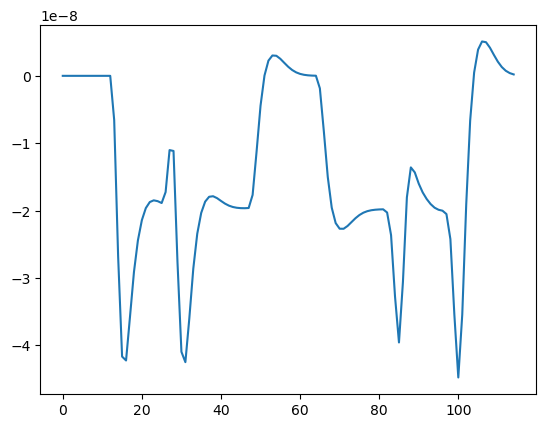

In [41]:
# plt.plot(s2_f[vox,:])
prms = np.array([-4.94300443e+00, -1.11640982e+01,  4.48715991e-01, -5.71585455e+00, -9.71780459e-14,  6.38403909e+00,  7.99882971e+00,  4.40946463e-08, 2.22733863e+00,  1.03599750e+00, -3.61252924e-34])
plt.plot(gg_norm.return_prediction(*prms).T, label = f'DN timecourse')

In [39]:
print(prms)

[-4.94300443e+00 -1.11640982e+01  4.48715991e-01 -5.71585455e+00
 -9.71780459e-14  6.38403909e+00  7.99882971e+00  4.40946463e-08
  2.22733863e+00  1.03599750e+00 -3.61252924e-34]


In [186]:
s2_f.shape

(277492, 115)

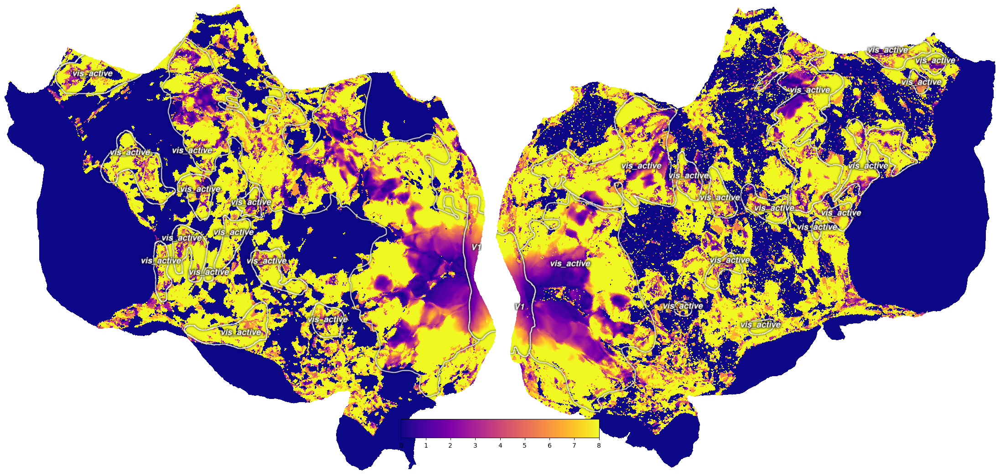

In [60]:
subject = 'sub-02'

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot = ecc(prf_gauss[:,1], prf_gauss[:,0]*-1)
# toplot = prf_dn[:,-1]
toplot[45274] = 0
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0, vmax=8), with_curvature=True);

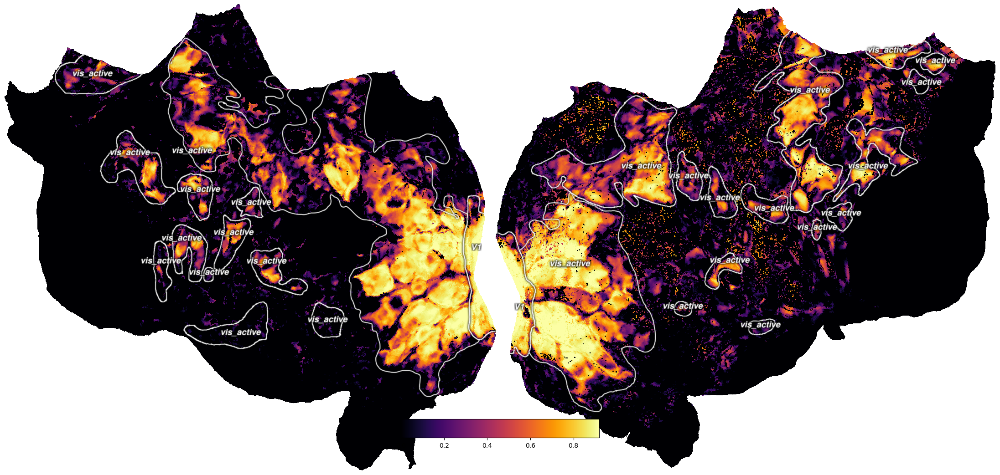

In [61]:
subject = 'sub-02'


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot = ecc(prf_dn[:,1], prf_dn[:,0]*-1)
toplot = prf_dn[:,-1]
cx.quickshow(cx.Vertex(toplot, subject, cmap='inferno', vmin=0), with_curvature=True);


# toplot = np.zeros([boolmask.shape[0],])
# toplot[:] = np.nan
# toplot[boolmask] = angle(cf_vis[:,-1], cf_vis[:,-2]*-1)
# cx.quickshow(cx.Vertex(toplot, subject, cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi), with_curvature=True);
# plt.title('polar angle visual space')


# toplot = np.zeros([boolmask.shape[0],])
# toplot[:] = np.nan
# toplot[boolmask] = angle(cf_logvis[:,-1], cf_logvis[:,-2]*-1)
# cx.quickshow(cx.Vertex(toplot, subject, cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi), with_curvature=True, with_colorbar=False);
# plt.title('polar angle logvisual space')

# toplot = np.zeros([boolmask.shape[0],])
# toplot[:] = np.nan
# toplot[boolmask] = angle(cf_cortical[:,-1], cf_cortical[:,-2]*-1)
# cx.quickshow(cx.Vertex(toplot, subject, cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi), with_curvature=True, with_colorbar=False);
# plt.title('polar angle cortical space')

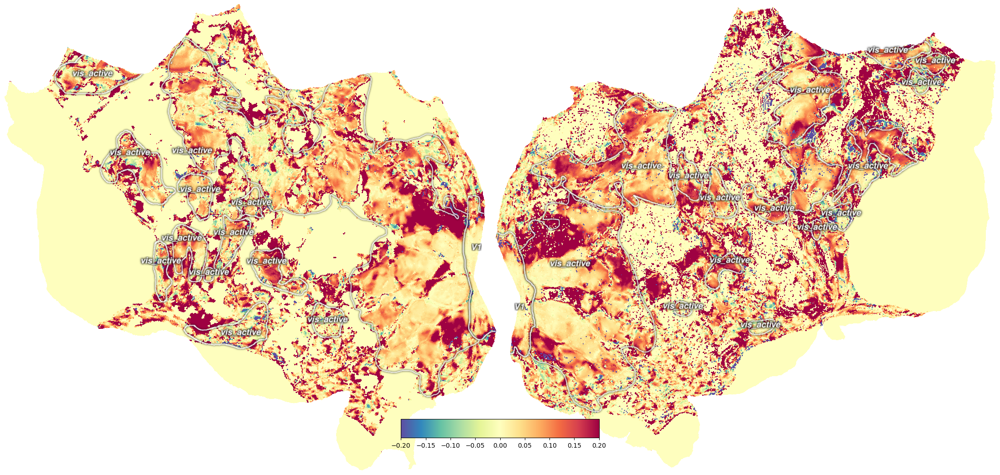

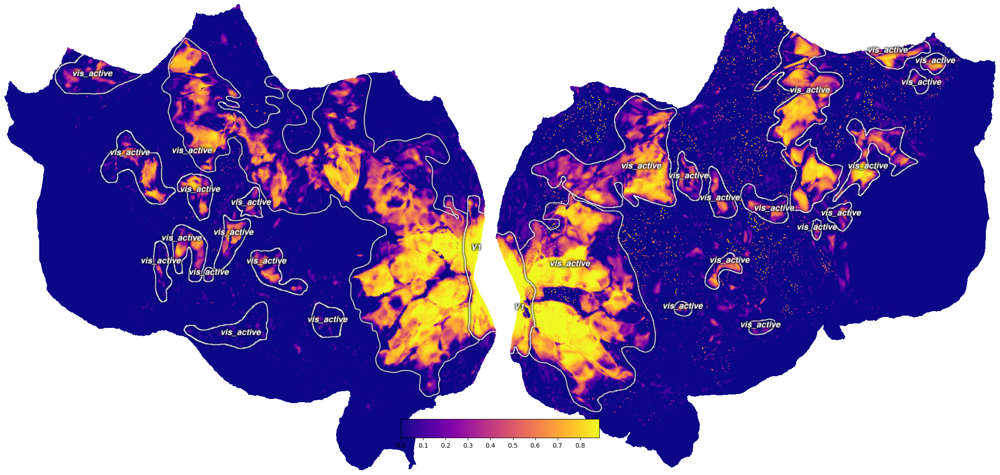

In [62]:
subject = 'sub-02'

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
# toplot = ecc(prf_dn[:,1], prf_dn[:,0]*-1)
toplot = prf_dn[:,-1] - prf_gauss[:,-1]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.2, vmax=0.2), with_curvature=True);



toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
# toplot = ecc(prf_dn[:,1], prf_dn[:,0]*-1)
toplot = prf_gauss[:,-1]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);

Text(0.5, 1.0, 'dn cort - gauss cort')

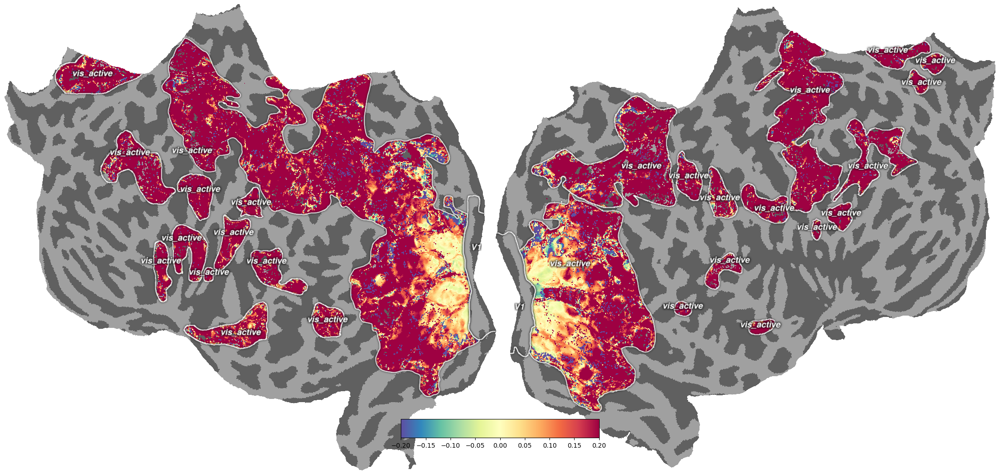

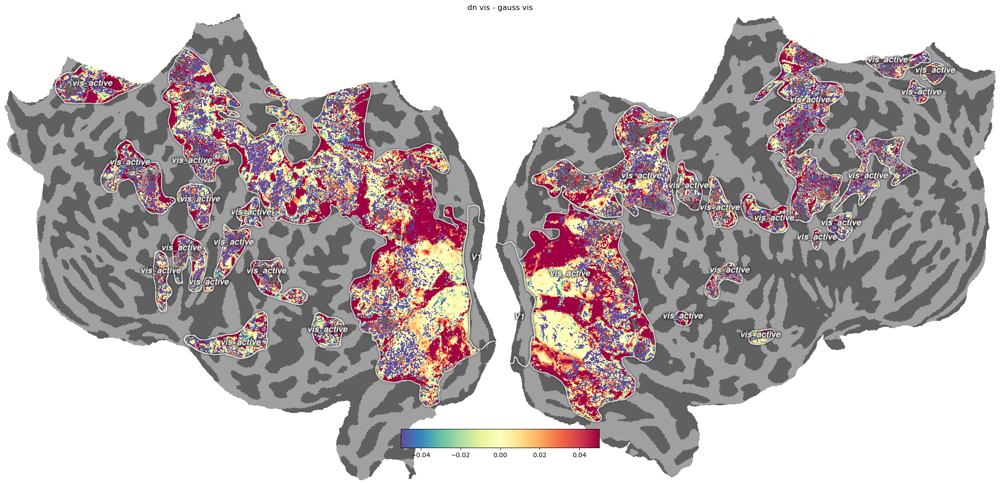

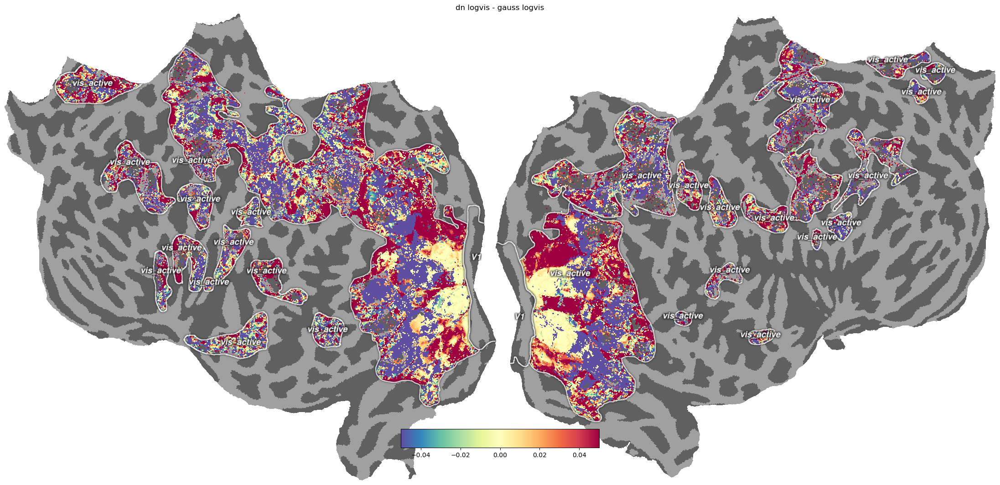

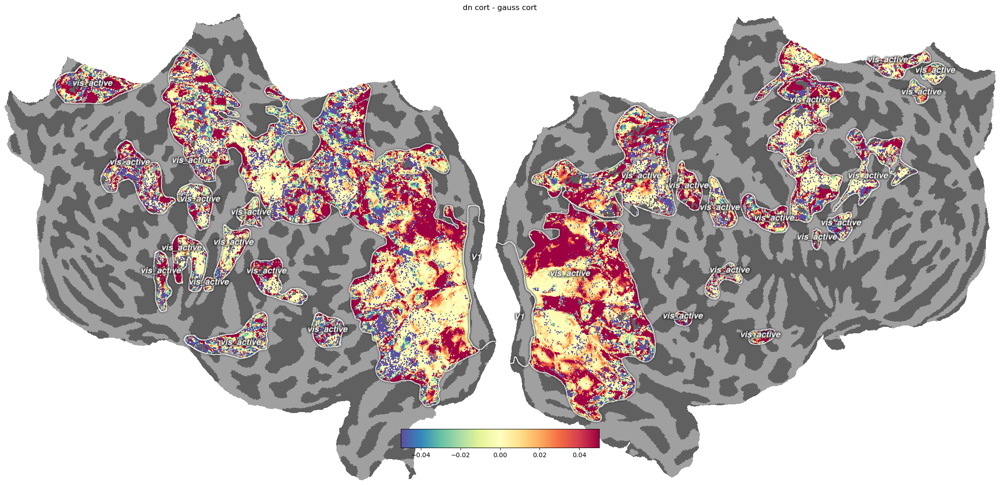

In [133]:
subject = 'sub-02'

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = prf_dn[:,-1][boolmask] - dncf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.2, vmax=0.2), with_curvature=True);


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_vis[:,-3] - cf_vis[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('dn vis - gauss vis')


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_logvis[:,-3] - cf_logvis[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('dn logvis - gauss logvis')

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_cortical[:,-3] - cf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('dn cort - gauss cort')

Text(0.5, 1.0, 'logvis - vis')

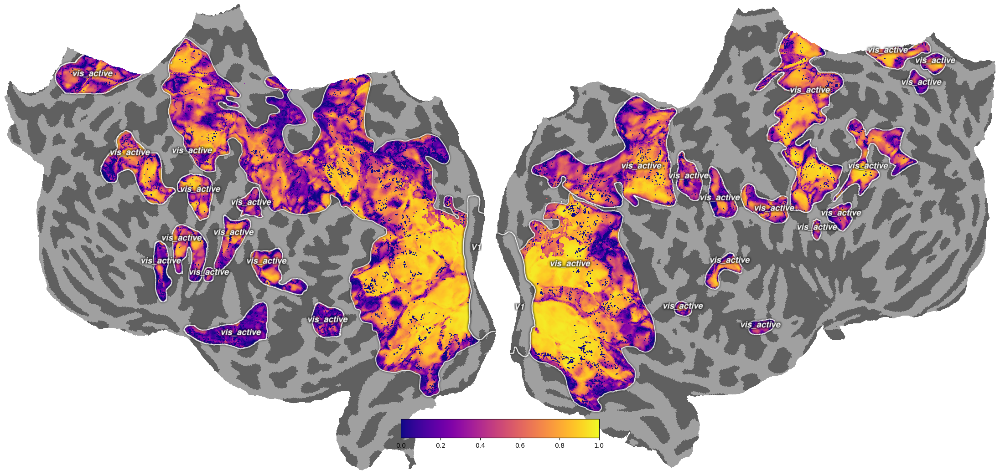

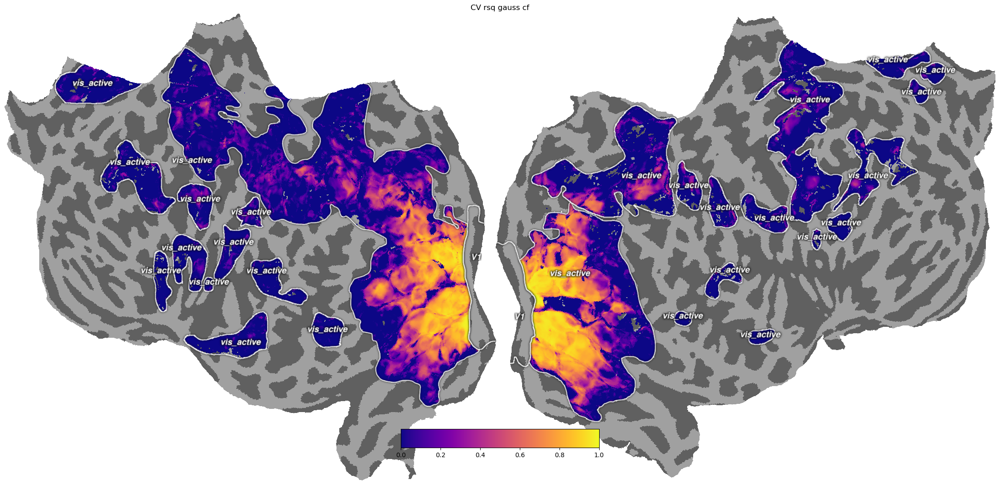

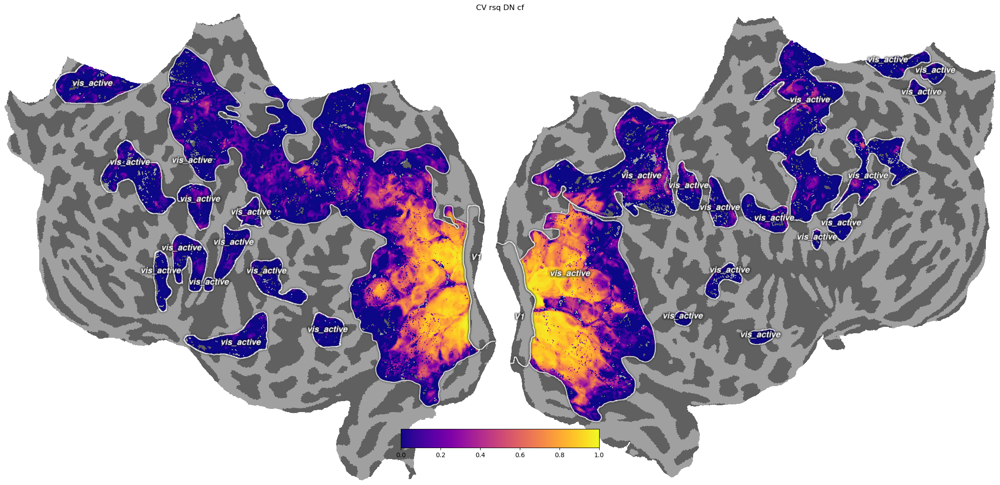

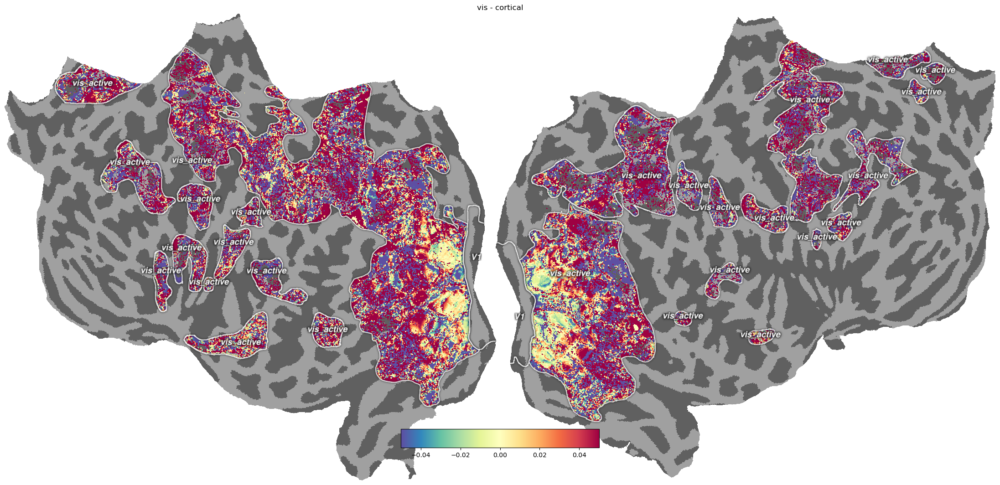

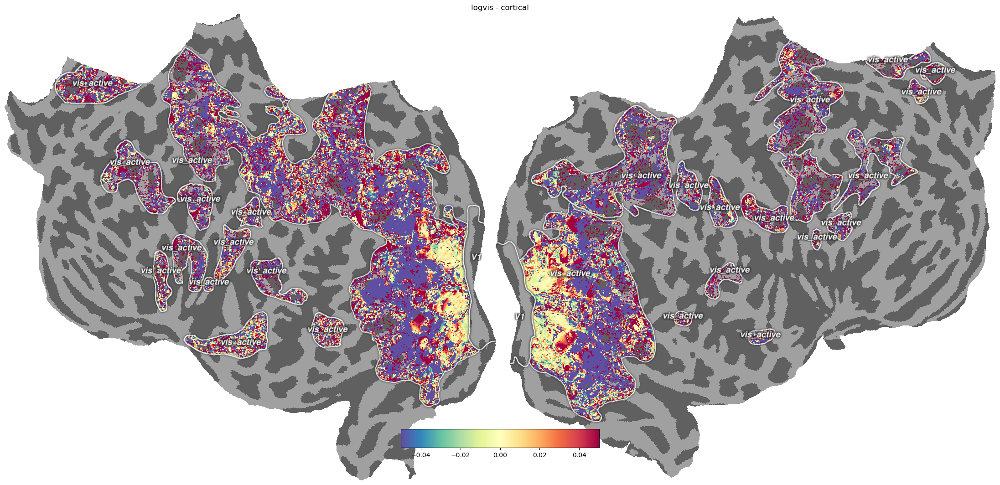

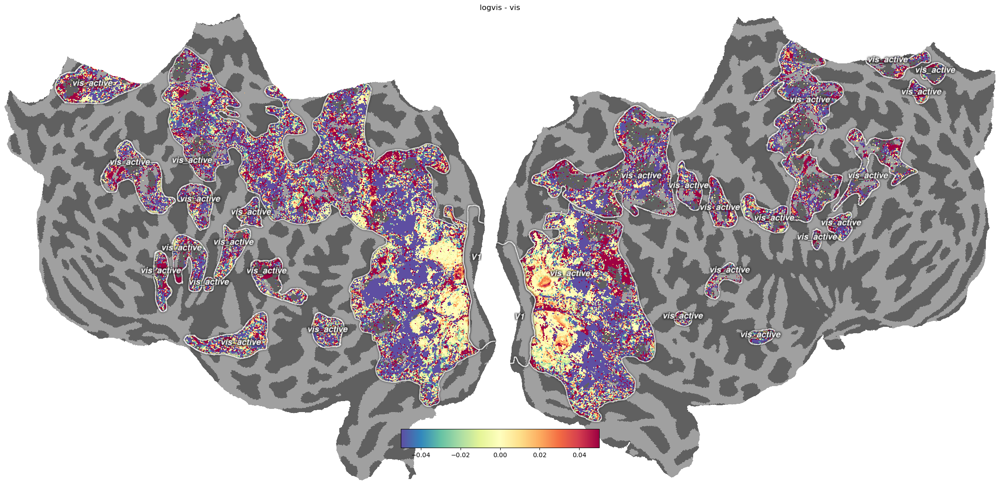

In [85]:
subject = 'sub-02'

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = prf_dn[:,-1][boolmask]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0, vmax=1), with_curvature=True);


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = cf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0, vmax=1), with_curvature=True);
plt.title('CV rsq gauss cf')

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0, vmax=1), with_curvature=True);
plt.title('CV rsq DN cf')


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_vis[:,-3] - dncf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('vis - cortical')


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_logvis[:,-3] - dncf_cortical[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('logvis - cortical')

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_logvis[:,-3] - dncf_vis[:,-3]
cx.quickshow(cx.Vertex(toplot, subject, cmap='spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
plt.title('logvis - vis')

In [79]:
prf_dn.shape

(277492, 8)

Text(0.5, 1.0, 'D param')

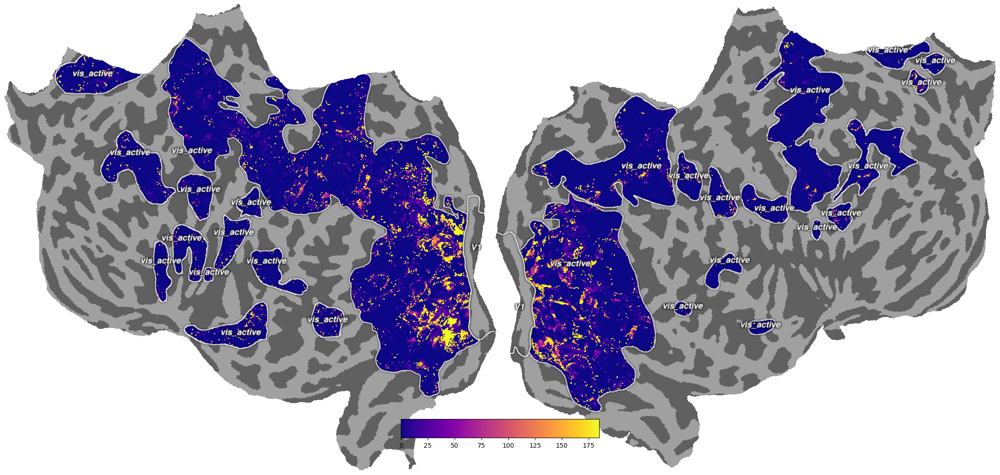

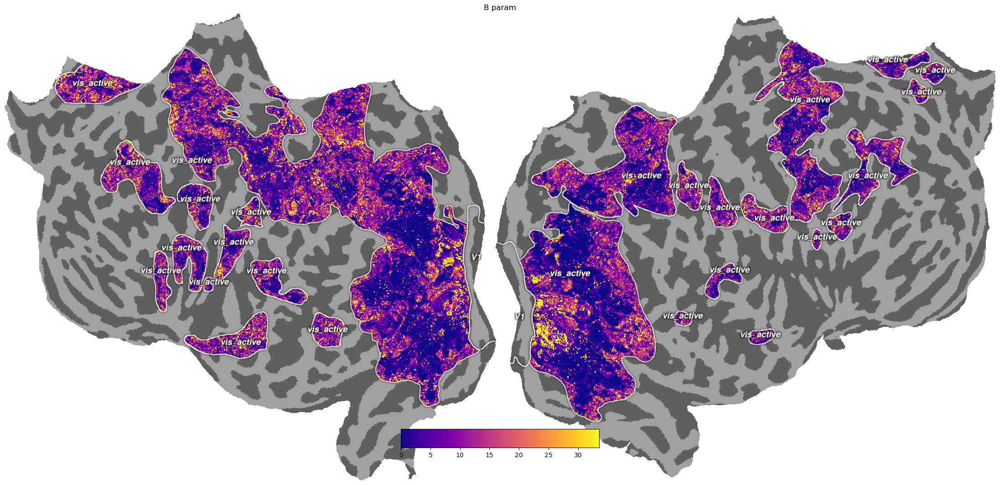

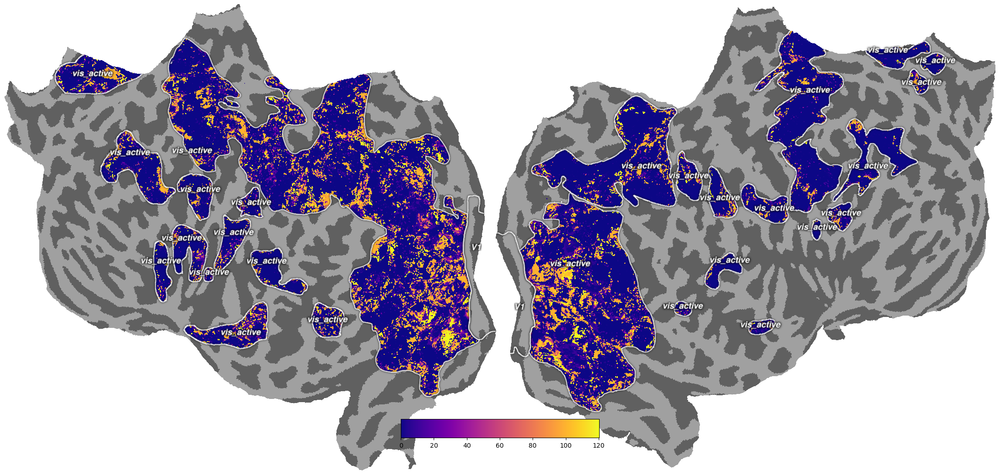

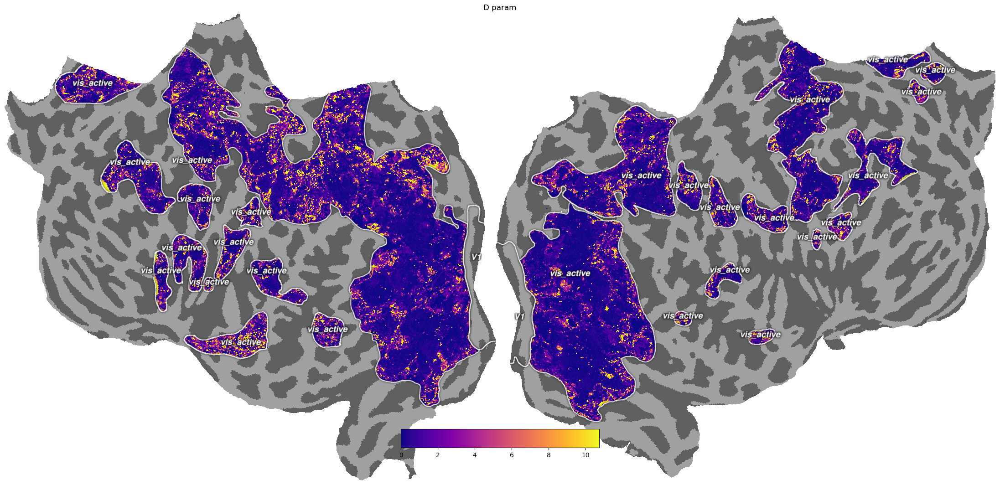

In [112]:
subject = 'sub-02'

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = prf_dn[:,7][boolmask]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_cortical[:,6]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);
plt.title('B param')


toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = prf_dn[:,8][boolmask]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);

toplot = np.zeros([boolmask.shape[0],])
toplot[:] = np.nan
toplot[boolmask] = dncf_cortical[:,7]
cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);
plt.title('D param')

In [117]:
[prf_dn[:,-1][boolmask] > 0.4]

33383

In [132]:
from scipy.stats import pearsonr, spearmanr

# toplot[boolmask] = prf_dn[:,8][boolmask]
# cx.quickshow(cx.Vertex(toplot, subject, cmap='plasma', vmin=0), with_curvature=True);

# toplot = np.zeros([boolmask.shape[0],])
# toplot[:] = np.nan
# toplot[boolmask] = dncf_cortical[:,7]

print(spearmanr(prf_dn[:,8][boolmask][prf_dn[:,-1][boolmask] > 0.1], dncf_cortical[:,7][prf_dn[:,-1][boolmask] > 0.1], nan_policy='omit'))


print(spearmanr(prf_dn[:,7][boolmask][prf_dn[:,-1][boolmask] > 0.1], dncf_cortical[:,6][prf_dn[:,-1][boolmask] > 0.1], nan_policy='omit'))


SpearmanrResult(correlation=0.012680097849935965, pvalue=0.00035743906922290294)
SpearmanrResult(correlation=-0.011902332515813525, pvalue=0.0008060932810968997)
